# Farmland & Crops Angle Correct
使用 [RotNet](https://github.com/d4nst/RotNet) 修正影像角度

In [9]:
import os
import sys
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

In [5]:
sys.path.append(os.path.abspath(os.path.join('..')))
from utils.metrics import evaluate
from utils.image import load_image_and_resize

In [6]:
# Top level data directory. Here we assume the format of the directory conforms to the ImageFolder structure
path = "."

# Folder of the training data
training_folder = 'D:/Dataset/aidea-farmland-crops-autumn/train'

# Folder of the corrected data
corrected_folder = 'D:/Dataset/aidea-farmland-crops-autumn/train-correct'

# Image size for model
image_size = 112

In [10]:
data = pd.read_csv(F"{path}/train_image_angle_mark_sample.csv")
labels = data.groupby('label').count().reset_index()['label']

## View
每個類別隨機抽選 10 張影像，比較原始影像與套用 RotNet 角度修正後的影像

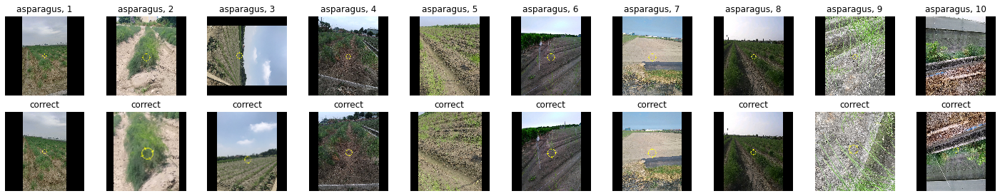

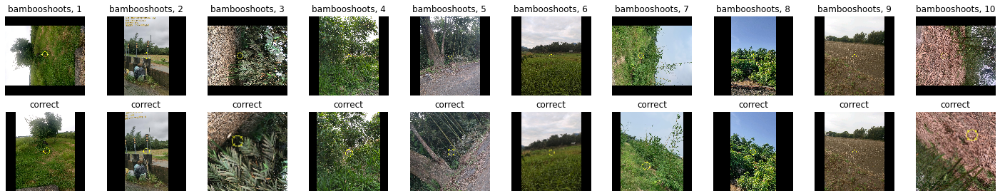

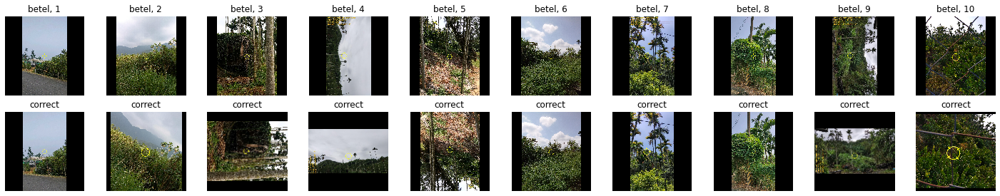

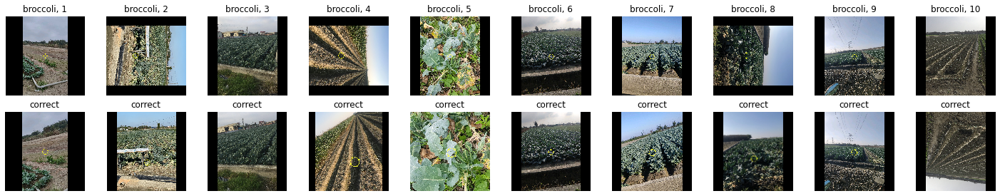

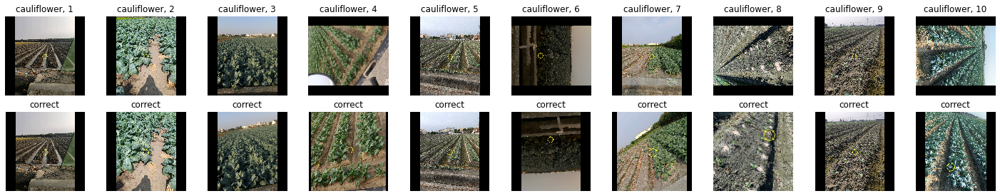

...

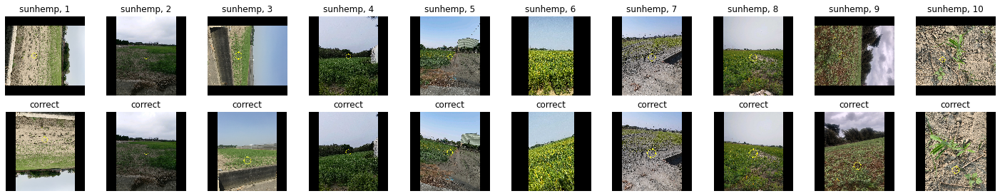

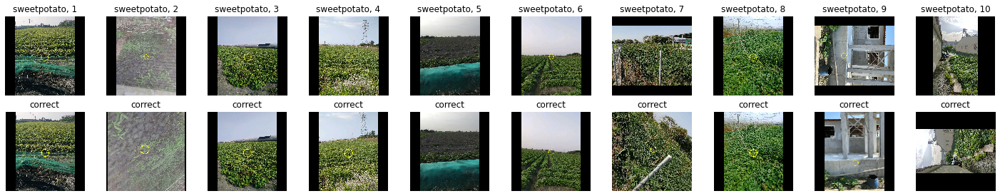

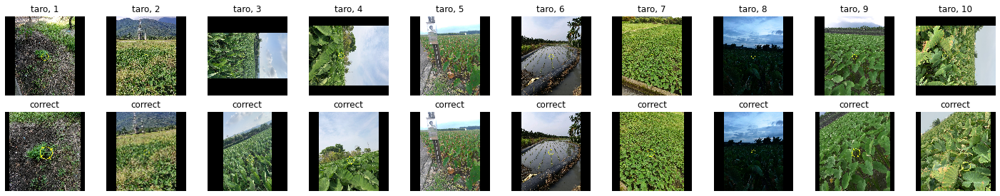

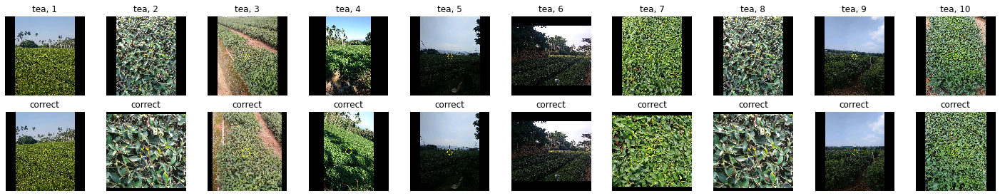

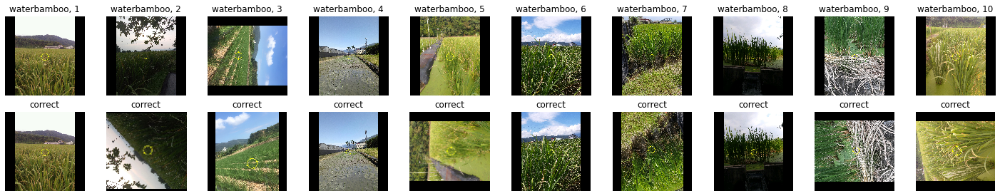

In [8]:
def row_based_idx(num_rows, num_cols, idx):
    return np.arange(1, num_rows*num_cols + 1).reshape((num_rows, num_cols)).transpose().flatten()[idx-1]

items = 10
variants = 1
for label in labels:
    plt.figure(figsize=(items * 2.5, variants * 4.5))
    filter_by_label = data[data['label'].eq(label)].reset_index(drop=True)
    for idx in range(items):
        row = filter_by_label.iloc[idx]
        filepath = F'{training_folder}/{row["label"]}/{row["file"]}'
        correctedpath = F'{corrected_folder}/{row["label"]}/{row["file"]}'
        original = load_image_and_resize(filepath, image_size)
        correct = load_image_and_resize(correctedpath, image_size)
        # plot: original
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, idx * (variants + 1) + 1))
        plt.imshow(original)
        plt.title("{}, {}".format(row["label"], idx + 1))
        plt.axis('off')
        # plot: correct
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, idx * (variants + 1) + 2))
        plt.imshow(correct)
        plt.title("correct")
        plt.axis('off')
    plt.show()

## Result
手工標記修正結果的時候，以每 45 度角為單位進行，總共有 8 種角度

In [11]:
data = pd.read_csv(F"{path}/train_image_angle_mark_sample.csv")

In [12]:
group_by_correct = data.groupby('correct.model').size().reset_index(name='counts')
group_by_correct['proportion'] = round(group_by_correct['counts'] / group_by_correct['counts'].sum(), 4)
group_by_correct

,correct.model,counts,proportion
0,0,230,0.6970
1,45,1,0.0030
2,90,12,0.0364
3,135,21,0.0636
4,180,34,0.1030
5,225,2,0.0061
6,270,17,0.0515
7,315,13,0.0394


為方便與原始角度進行比較，將 8 種角度轉換縮減至 4 種

In [13]:
correct = data.copy()
# if correct > 270 = 270
correct['correct.model'] = correct['correct.model'].apply(lambda x: 270 if x > 270 else x)
# if 270 > correct > 180 = 180
correct['correct.model'] = correct['correct.model'].apply(lambda x: 180 if (x > 180 and x < 270) else x)
# if 180 > correct > 90 = 90
correct['correct.model'] = correct['correct.model'].apply(lambda x: 90 if (x > 90 and x < 180) else x)
# if 90 > correct > 0 = 0
correct['correct.model'] = correct['correct.model'].apply(lambda x: 0 if (x > 0 and x < 90) else x)

套用角度修正模型後，往 -90 (+270) 度歪斜的影像減少，但往 -180 度及 -270 (+90) 度歪斜的影像增加

angle

In [16]:
group_by_angle = correct.groupby('angle').size().reset_index(name='counts')
group_by_angle['proportion'] = round(group_by_angle['counts'] / group_by_angle['counts'].sum(), 4)
group_by_angle

,angle,counts,proportion
0,0,246,0.7455
1,90,5,0.0152
2,180,1,0.0030
3,270,78,0.2364


correct.model	

In [14]:
group_by_correct = correct.groupby('correct.model').size().reset_index(name='counts')
group_by_correct['proportion'] = round(group_by_correct['counts'] / group_by_correct['counts'].sum(), 4)
group_by_correct

,correct.model,counts,proportion
0,0,231,0.7000
1,90,33,0.1000
2,180,36,0.1091
3,270,30,0.0909


In [17]:
pd.DataFrame(evaluate(correct['angle'].tolist(), correct['correct.model'].tolist())).T

,precision,recall,f1-score,support
0,0.735931,0.691057,0.712788,246.000000
90,0.030303,0.200000,0.052632,5.000000
180,0.000000,0.000000,0.000000,1.000000
270,0.133333,0.051282,0.074074,78.000000
accuracy,0.530303,0.530303,0.530303,0.530303
macro avg,0.224892,0.235585,0.209873,330.000000
weighted avg,0.580577,0.530303,0.549657,330.000000
